# **DISEASE SEVERITY PREDICTION**

**Installing mljar-supervised library**

In [3]:
!pip install mljar-supervised

  Using cached mljar-supervised-0.11.1.tar.gz (111 kB)
     |████████████████████████████████| 3.4 MB 29.3 MB/s 
     |████████████████████████████████| 11.3 MB 20.9 MB/s 
     |████████████████████████████████| 38.2 MB 25 kB/s 
     |████████████████████████████████| 23.2 MB 1.7 MB/s 
     |████████████████████████████████| 173.5 MB 57 kB/s 
     |████████████████████████████████| 2.0 MB 51.3 MB/s 
     |████████████████████████████████| 76.3 MB 22 kB/s 
     |████████████████████████████████| 61 kB 481 kB/s 
     |████████████████████████████████| 319 kB 55.1 MB/s 
     |████████████████████████████████| 366 kB 61.4 MB/s 
     |████████████████████████████████| 82 kB 437 kB/s 
     |████████████████████████████████| 308 kB 51.7 MB/s 
     |████████████████████████████████| 25.3 MB 85 kB/s 
     |████████████████████████████████| 80 kB 10.4 MB/s 
     |████████████████████████████████| 209 kB 57.0 MB/s 
     |████████████████████████████████| 75 kB 5.2 MB/s 
     |████████████████████

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


**Importing necessary libraries**

In [1]:
import numpy as np
import pandas as pd
from matplotlib import pyplot
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_recall_fscore_support
from supervised.automl import AutoML
import joblib

# **CARDIOVASCULAR**

In [2]:
df1 = pd.read_csv("disease/cardio_dataset.csv")

In [3]:
df1.head()

,AGE,GENDER,HEIGHT,WEIGHT,AP_HIGH,AP_LOW,CHOLESTEROL,GLUCOSE,SMOKE,ALCOHOL,CARDIO_DISEASE
0,50,2,168,62,110,80,1,1,0,0,0
1,55,1,156,85,140,90,3,1,0,0,1
2,52,1,165,64,130,70,3,1,0,0,1
3,48,2,169,82,150,100,1,1,0,0,1
4,48,1,156,56,100,60,1,1,0,0,0


In [4]:
X = df1.drop('CARDIO_DISEASE',axis = 1)
y = df1['CARDIO_DISEASE']

In [5]:
model = DecisionTreeClassifier()
model.fit(X, y)
importance = model.feature_importances_
for i,v in enumerate(importance):
    print('Feature: %0d, Score: %.5f' % (i,v))

Feature: 0, Score: 0.14153
Feature: 1, Score: 0.02546
Feature: 2, Score: 0.20573
Feature: 3, Score: 0.22896
Feature: 4, Score: 0.25018
Feature: 5, Score: 0.05752
Feature: 6, Score: 0.03915
Feature: 7, Score: 0.02680
Feature: 8, Score: 0.01365
Feature: 9, Score: 0.01103


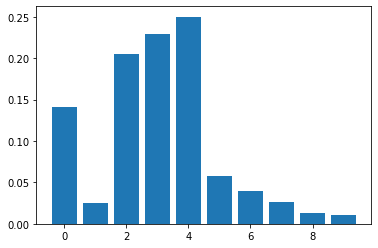

In [6]:
pyplot.bar([x for x in range(len(importance))], importance)
pyplot.show()

Total no of samples that includes both **cardio-disease** and **no cardio-disease** samples

In [7]:
print("Total samples:",df1.shape)

Total samples: (68783, 11)


Filtering only the samples with **cardio-disease**

In [8]:
df1 = df1[df1['CARDIO_DISEASE'] == 1]
print("Samples having only cardio-disease:",df1.shape)

Samples having only cardio-disease: (34041, 11)


In [9]:
#AGE,height,weight,AP_HIGH

df1_age = df1['AGE'].mean()
df1_height = df1['HEIGHT'].mean()
df1_weight = df1['WEIGHT'].mean()
df1_ap_high = df1['AP_HIGH'].mean()

df1_threshold = (df1_age + df1_height + df1_weight + df1_ap_high) / 4
df1_threshold

107.44287770629535

In [10]:
res1 = []
for index, row in df1.iterrows():
    c = (row['AGE'] + row['HEIGHT'] + row['WEIGHT'] + row['AP_HIGH'])/4
    if c > df1_threshold:
        res1.append(1)
    else:
        res1.append(0)

In [11]:
df1['SEVERITY'] = res1
df1 = df1.drop('CARDIO_DISEASE',axis = 1)

In [12]:
df1.head(10)

,AGE,GENDER,HEIGHT,WEIGHT,AP_HIGH,AP_LOW,CHOLESTEROL,GLUCOSE,SMOKE,ALCOHOL,SEVERITY
1,55,1,156,85,140,90,3,1,0,0,1
2,52,1,165,64,130,70,3,1,0,0,0
3,48,2,169,82,150,100,1,1,0,0,1
7,62,2,178,95,130,90,3,3,0,0,1
15,46,2,172,112,120,80,1,1,0,0,1
22,63,1,158,90,145,85,2,2,0,0,1
24,46,1,170,68,150,90,3,1,0,0,1
30,50,1,155,105,120,80,3,1,0,0,1
31,64,1,169,71,140,90,3,1,0,0,1
33,57,1,160,73,130,85,1,1,0,0,0


In [13]:
X = df1.drop('SEVERITY',axis = 1)
y = df1['SEVERITY']

In [14]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1)

In [15]:
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(30636, 10)
(30636,)
(3405, 10)
(3405,)


In [16]:
automl = AutoML(total_time_limit=5*60,eval_metric="accuracy")

In [17]:
automl.fit(X_train,y_train)

Linear algorithm was disabled.
AutoML directory: AutoML_1
The task is binary_classification with evaluation metric accuracy
AutoML will use algorithms: ['Baseline', 'Decision Tree', 'Random Forest', 'Xgboost', 'Neural Network']
AutoML will ensemble available models
AutoML steps: ['simple_algorithms', 'default_algorithms', 'ensemble']
* Step simple_algorithms will try to check up to 2 models
1_Baseline accuracy 0.526439 trained in 0.89 seconds
2_DecisionTree accuracy 0.875441 trained in 56.95 seconds
* Step default_algorithms will try to check up to 3 models
3_Default_Xgboost accuracy 0.989033 trained in 24.48 seconds
4_Default_NeuralNetwork accuracy 1.0 trained in 13.27 seconds
5_Default_RandomForest accuracy 0.913957 trained in 8.61 seconds
* Step ensemble will try to check up to 1 model
Ensemble accuracy 1.0 trained in 0.69 seconds
AutoML fit time: 128.11 seconds
AutoML best model: 4_Default_NeuralNetwork


AutoML(eval_metric='accuracy', total_time_limit=300)

In [3]:
automl.report()

In [ ]:
Pkl_Filename = "/content/drive/MyDrive/disease/model/cardio_model.pkl"  

In [ ]:
#Saving the model
with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(automl, file)

In [ ]:
with open(Pkl_Filename, 'rb') as file:  
    cardio_model = pickle.load(file)

In [18]:
filename = 'models/cardio_model.sav'
joblib.dump(automl,filename)

['models/cardio_model.sav']

In [2]:
automl = joblib.load('models/cardio_model.sav')

In [19]:
y_predicted = automl.predict(X_test)

In [20]:
print("Accuracy:",accuracy_score(y_test, y_predicted))

Accuracy: 1.0


**Checking the model**

In [21]:
data = np.array([[62,1,180,80,130,85,1,2,1,0]])
index = [1]
col = ['AGE','GENDER','HEIGHT','WEIGHT','AP_HIGH','AP_LOW','CHOLESTEROL','GLUCOSE'	,'SMOKE'	,'ALCOHOL']
test1 = pd.DataFrame(data,index,col) 
test1

,AGE,GENDER,HEIGHT,WEIGHT,AP_HIGH,AP_LOW,CHOLESTEROL,GLUCOSE,SMOKE,ALCOHOL
1,62,1,180,80,130,85,1,2,1,0


In [23]:
predict = automl.predict_proba(test1)
predicted = predict[0]
print(predicted)

[0. 1.]


In [24]:
if(predicted[1] > predicted[0]):
    print("Severity:Malignant")
else:
    print("Severity:Benign")

Severity:Malignant


# **JAUNDICE**

In [2]:
df2 = pd.read_csv("disease/jaundice_dataset.csv")
df2.head()

,AGE,GENDER,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Total_Protiens,Albumin,jaundice
0,65,1,0.7,0.1,187,16,6.8,3.3,1
1,62,0,10.9,5.5,699,64,7.5,3.2,1
2,62,0,7.3,4.1,490,60,7.0,3.3,1
3,58,0,1.0,0.4,182,14,6.8,3.4,1
4,72,0,3.9,2.0,195,27,7.3,2.4,1


In [3]:
X = df2.drop('jaundice',axis = 1)
y = df2['jaundice']

In [4]:
model = DecisionTreeClassifier()
model.fit(X, y)
importance = model.feature_importances_
for i,v in enumerate(importance):
    print('Feature: %0d, Score: %.5f' % (i,v))

Feature: 0, Score: 0.19839
Feature: 1, Score: 0.02538
Feature: 2, Score: 0.15731
Feature: 3, Score: 0.05305
Feature: 4, Score: 0.16696
Feature: 5, Score: 0.15100
Feature: 6, Score: 0.13653
Feature: 7, Score: 0.11138


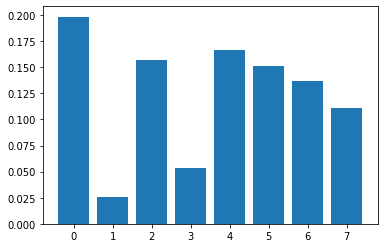

In [5]:
pyplot.bar([x for x in range(len(importance))], importance)
pyplot.show()

In [6]:
print("Total samples:",df2.shape)

Total samples: (583, 9)


In [7]:
df2 = df2[df2['jaundice'] == 1]
print("Samples having only jaundice-disease:",df2.shape)

Samples having only jaundice-disease: (416, 9)


In [8]:
f1 = df2['AGE'].mean()
f2 = df2['Total_Bilirubin'].mean()
f3 = df2['Alkaline_Phosphotase'].mean()
f4 = df2['Total_Protiens'].mean()

th2 = (f1+f2+f3+f4) / 4
th2

93.94615384615386

In [9]:
res2 = []
for index, row in df2.iterrows():
    c = (row['AGE'] + row['Total_Bilirubin'] + row['Alkaline_Phosphotase'] + row['Total_Protiens'])/4
    if c > th2:
        res2.append(1)
    else:
        res2.append(0)

In [10]:
df2['SEVERITY'] = res2
df2 = df2.drop('jaundice',axis = 1)

In [11]:
df2.head(10)

,AGE,GENDER,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Total_Protiens,Albumin,SEVERITY
0,65,1,0.7,0.1,187,16,6.8,3.3,0
1,62,0,10.9,5.5,699,64,7.5,3.2,1
2,62,0,7.3,4.1,490,60,7.0,3.3,1
3,58,0,1.0,0.4,182,14,6.8,3.4,0
4,72,0,3.9,2.0,195,27,7.3,2.4,0
5,46,0,1.8,0.7,208,19,7.6,4.4,0
6,26,1,0.9,0.2,154,16,7.0,3.5,0
7,29,1,0.9,0.3,202,14,6.7,3.6,0
9,55,0,0.7,0.2,290,53,6.8,3.4,0
10,57,0,0.6,0.1,210,51,5.9,2.7,0


In [12]:
X = df2.drop('SEVERITY',axis = 1)
y = df2['SEVERITY']

In [13]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.05)

In [14]:
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(395, 8)
(395,)
(21, 8)
(21,)


In [15]:
jaundice_model = AutoML(total_time_limit=6*60,eval_metric="accuracy")

In [16]:
jaundice_model.fit(X_train,y_train)

AutoML directory: AutoML_2
The task is binary_classification with evaluation metric accuracy
AutoML will use algorithms: ['Baseline', 'Linear', 'Decision Tree', 'Random Forest', 'Xgboost', 'Neural Network']
AutoML will ensemble available models
AutoML steps: ['simple_algorithms', 'default_algorithms', 'ensemble']
* Step simple_algorithms will try to check up to 3 models
1_Baseline accuracy 0.757576 trained in 0.37 seconds
2_DecisionTree accuracy 0.989899 trained in 24.6 seconds
3_Linear accuracy 0.969697 trained in 3.87 seconds
* Step default_algorithms will try to check up to 3 models
4_Default_Xgboost accuracy 0.989899 trained in 4.5 seconds
5_Default_NeuralNetwork accuracy 0.969697 trained in 1.15 seconds
6_Default_RandomForest accuracy 0.989899 trained in 3.05 seconds
* Step ensemble will try to check up to 1 model
Ensemble accuracy 0.989899 trained in 0.26 seconds
AutoML fit time: 49.01 seconds
AutoML best model: 2_DecisionTree


AutoML(eval_metric='accuracy', total_time_limit=360)

In [17]:
jaundice_model.report()

In [18]:
filename = 'models/jaundice_model.sav'
joblib.dump(jaundice_model,filename)

['models/jaundice_model.sav']

In [19]:
y_predicted = jaundice_model.predict(X_test)

In [20]:
print("Accuracy:",accuracy_score(y_test, y_predicted))

Accuracy: 1.0


**Checking the model**

In [21]:
data = np.array([[60,0,1.2,0.3,500,65,7.2,3.2]])
index = [1]
col = ['AGE','GENDER','Total_Bilirubin','Direct_Bilirubin',	'Alkaline_Phosphotase',	'Alamine_Aminotransferase',	'Total_Protiens',	'Albumin']
test2 = pd.DataFrame(data,index,col) 
test2

,AGE,GENDER,Total_Bilirubin,Direct_Bilirubin,Alkaline_Phosphotase,Alamine_Aminotransferase,Total_Protiens,Albumin
1,60.0,0.0,1.2,0.3,500.0,65.0,7.2,3.2


In [22]:
predict = jaundice_model.predict_proba(test2)
predicted = predict[0]
print(predicted)

[0. 1.]


In [23]:
if(predicted[1] > predicted[0]):
    print("Severity:Malignant")
else:
    print("Severity:Benign")

Severity:Malignant


# **ALLERGY**

In [24]:
df3 = pd.read_csv("disease/allergy_cold_dataset.csv")
df3.head()

,COUGH,MUSCLE_ACHES,TIREDNESS,SORE_THROAT,RUNNY_NOSE,FEVER,NAUSEA,VOMITING,DIARRHEA,DIFFICULTY_BREATHING,LOSS_OF_TASTE,LOSS_OF_SMELL,SNEEZING,PINK_EYE,TYPE
0,0,0,1,0,1,0,0,0,0,0,1,0,0,1,ALLERGY
1,0,0,1,0,0,0,0,0,0,0,1,0,1,1,ALLERGY
2,0,1,1,1,0,0,0,0,0,0,1,0,0,1,ALLERGY
3,0,0,0,1,1,0,0,0,0,0,1,1,1,1,ALLERGY
4,0,0,1,0,1,0,0,0,0,0,1,1,1,1,ALLERGY


In [25]:
df3 = df3[df3['TYPE'] == 'ALLERGY']
df3.shape

(16381, 15)

In [26]:
print("Count of COUGH" , len(df3[df3['COUGH'] == 1]))
print("Count of MUSCLE_ACHES" , len(df3[df3['MUSCLE_ACHES'] == 1]))
print("Count of TIREDNESS" , len(df3[df3['TIREDNESS'] == 1]))
print("Count of SORE_THROAT" , len(df3[df3['SORE_THROAT'] == 1]))
print("Count of RUNNY_NOSE" , len(df3[df3['RUNNY_NOSE'] == 1]))
print("Count of FEVER" , len(df3[df3['FEVER'] == 1]))
print("Count of NAUSEA" , len(df3[df3['NAUSEA'] == 1]))
print("Count of VOMITING" , len(df3[df3['VOMITING'] == 1]))
print("Count of DIARRHEA" , len(df3[df3['DIARRHEA'] == 1]))
print("Count of DIFFICULTY_BREATHING" , len(df3[df3['DIFFICULTY_BREATHING'] == 1]))
print("Count of LOSS_OF_TASTE" , len(df3[df3['LOSS_OF_TASTE'] == 1]))
print("Count of LOSS_OF_SMEL" , len(df3[df3['LOSS_OF_SMELL'] == 1]))
print("Count of SNEEZING" , len(df3[df3['SNEEZING'] == 1]))
print("Count of PINK_EYE" , len(df3[df3['PINK_EYE'] == 1]))


Count of COUGH 8191
Count of MUSCLE_ACHES 8191
Count of TIREDNESS 8190
Count of SORE_THROAT 8189
Count of RUNNY_NOSE 8192
Count of FEVER 0
Count of NAUSEA 0
Count of VOMITING 0
Count of DIARRHEA 0
Count of DIFFICULTY_BREATHING 0
Count of LOSS_OF_TASTE 8191
Count of LOSS_OF_SMEL 8190
Count of SNEEZING 8191
Count of PINK_EYE 8190


In [27]:
att = ['COUGH','MUSCLE_ACHES','TIREDNESS','SORE_THROAT','RUNNY_NOSE','LOSS_OF_TASTE','LOSS_OF_SMELL','SNEEZING','PINK_EYE']
df3 = df3[att]
print("Total Samples:",df3.shape)

Total Samples: (16381, 9)


In [28]:
th3 = 6
res3 = []
for index,row in df3.iterrows():
    d = dict(row)
    val = list(d.values()).count(1)
    if val >= th3:
        res3.append(1)
    else:
        res3.append(0)

In [29]:
df3['SEVERITY'] = res3

In [30]:
df3.head(10)

,COUGH,MUSCLE_ACHES,TIREDNESS,SORE_THROAT,RUNNY_NOSE,LOSS_OF_TASTE,LOSS_OF_SMELL,SNEEZING,PINK_EYE,SEVERITY
0,0,0,1,0,1,1,0,0,1,0
1,0,0,1,0,0,1,0,1,1,0
2,0,1,1,1,0,1,0,0,1,0
3,0,0,0,1,1,1,1,1,1,1
4,0,0,1,0,1,1,1,1,1,1
5,0,0,0,0,0,0,1,1,1,0
6,1,0,0,0,1,0,0,0,1,0
7,0,1,1,1,0,1,1,1,1,1
8,1,1,0,0,1,0,1,1,0,0
9,1,0,1,1,1,0,1,1,0,1


In [31]:
X = df3.drop('SEVERITY',axis = 1)
y = df3['SEVERITY']

In [32]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1)

In [33]:
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(14742, 9)
(14742,)
(1639, 9)
(1639,)


In [34]:
allergy_model = AutoML(total_time_limit=5*60,eval_metric="accuracy")

In [35]:
allergy_model.fit(X_train,y_train)

Linear algorithm was disabled.
AutoML directory: AutoML_3
The task is binary_classification with evaluation metric accuracy
AutoML will use algorithms: ['Baseline', 'Decision Tree', 'Random Forest', 'Xgboost', 'Neural Network']
AutoML will ensemble available models
AutoML steps: ['simple_algorithms', 'default_algorithms', 'ensemble']
* Step simple_algorithms will try to check up to 2 models
1_Baseline accuracy 0.746337 trained in 0.41 seconds
2_DecisionTree accuracy 0.776994 trained in 20.36 seconds
* Step default_algorithms will try to check up to 3 models
3_Default_Xgboost accuracy 1.0 trained in 5.42 seconds
4_Default_NeuralNetwork accuracy 1.0 trained in 3.2 seconds
5_Default_RandomForest accuracy 0.855941 trained in 4.71 seconds
* Step ensemble will try to check up to 1 model
Ensemble accuracy 1.0 trained in 0.87 seconds
AutoML fit time: 42.59 seconds
AutoML best model: 3_Default_Xgboost


AutoML(eval_metric='accuracy', total_time_limit=300)

In [36]:
allergy_model.report()

In [37]:
filename = 'models/allergy_model.sav'
joblib.dump(allergy_model,filename)

['models/allergy_model.sav']

In [38]:
y_predicted = allergy_model.predict(X_test)

In [39]:
print("Accuracy:",accuracy_score(y_test, y_predicted))

Accuracy: 1.0


**Checking the model**

In [40]:
data = np.array([[1,0,1,1,0,0,0,1,1]])
index = [1]
col = ['COUGH',	'MUSCLE_ACHES',	'TIREDNESS','SORE_THROAT','RUNNY_NOSE',	'LOSS_OF_TASTE','LOSS_OF_SMELL','SNEEZING','PINK_EYE']
test3 = pd.DataFrame(data,index,col) 
test3

,COUGH,MUSCLE_ACHES,TIREDNESS,SORE_THROAT,RUNNY_NOSE,LOSS_OF_TASTE,LOSS_OF_SMELL,SNEEZING,PINK_EYE
1,1,0,1,1,0,0,0,1,1


In [41]:
predict = allergy_model.predict_proba(test3)
predicted = predict[0]
print(predicted)

[0.84229904 0.15770097]


In [42]:
if(predicted[1] > predicted[0]):
    print("Severity:Malignant")
else:
    print("Severity:Benign")

Severity:Benign


# **COMMON COLD**

In [43]:
df4 = pd.read_csv("disease/allergy_cold_dataset.csv")
df4.head()

,COUGH,MUSCLE_ACHES,TIREDNESS,SORE_THROAT,RUNNY_NOSE,FEVER,NAUSEA,VOMITING,DIARRHEA,DIFFICULTY_BREATHING,LOSS_OF_TASTE,LOSS_OF_SMELL,SNEEZING,PINK_EYE,TYPE
0,0,0,1,0,1,0,0,0,0,0,1,0,0,1,ALLERGY
1,0,0,1,0,0,0,0,0,0,0,1,0,1,1,ALLERGY
2,0,1,1,1,0,0,0,0,0,0,1,0,0,1,ALLERGY
3,0,0,0,1,1,0,0,0,0,0,1,1,1,1,ALLERGY
4,0,0,1,0,1,0,0,0,0,0,1,1,1,1,ALLERGY


In [44]:
df4 = df4[df4['TYPE'] == 'COLD']
print("Total samples:",df4.shape)

Total samples: (1024, 15)


In [45]:
print("Count of COUGH" , len(df4[df4['COUGH'] == 1]))
print("Count of MUSCLE_ACHES" , len(df4[df4['MUSCLE_ACHES'] == 1]))
print("Count of TIREDNESS" , len(df4[df4['TIREDNESS'] == 1]))
print("Count of SORE_THROAT" , len(df4[df4['SORE_THROAT'] == 1]))
print("Count of RUNNY_NOSE" , len(df4[df4['RUNNY_NOSE'] == 1]))
print("Count of FEVER" , len(df4[df4['FEVER'] == 1]))
print("Count of NAUSEA" , len(df4[df4['NAUSEA'] == 1]))
print("Count of VOMITING" , len(df4[df4['VOMITING'] == 1]))
print("Count of DIARRHEA" , len(df4[df4['DIARRHEA'] == 1]))
print("Count of DIFFICULTY_BREATHING" , len(df4[df4['DIFFICULTY_BREATHING'] == 1]))
print("Count of LOSS_OF_TASTE" , len(df4[df4['LOSS_OF_TASTE'] == 1]))
print("Count of LOSS_OF_SMEL" , len(df4[df4['LOSS_OF_SMELL'] == 1]))
print("Count of SNEEZING" , len(df4[df4['SNEEZING'] == 1]))
print("Count of PINK_EYE" , len(df4[df4['PINK_EYE'] == 1]))


Count of COUGH 512
Count of MUSCLE_ACHES 512
Count of TIREDNESS 512
Count of SORE_THROAT 512
Count of RUNNY_NOSE 512
Count of FEVER 512
Count of NAUSEA 0
Count of VOMITING 0
Count of DIARRHEA 0
Count of DIFFICULTY_BREATHING 0
Count of LOSS_OF_TASTE 512
Count of LOSS_OF_SMEL 512
Count of SNEEZING 512
Count of PINK_EYE 0


In [46]:
att = ['COUGH','MUSCLE_ACHES','TIREDNESS','SORE_THROAT','RUNNY_NOSE','FEVER','LOSS_OF_TASTE','LOSS_OF_SMELL','SNEEZING']
df4 = df4[att]
df4.shape

(1024, 9)

In [47]:
th4 = 6
res4 = []
for index,row in df4.iterrows():
    d = dict(row)
    val = list(d.values()).count(1)
    if val >= th4:
        res4.append(1)
    else:
        res4.append(0)

In [48]:
df4['SEVERITY'] = res4

In [49]:
df4.head(10)

,COUGH,MUSCLE_ACHES,TIREDNESS,SORE_THROAT,RUNNY_NOSE,FEVER,LOSS_OF_TASTE,LOSS_OF_SMELL,SNEEZING,SEVERITY
16381,0,1,1,0,1,1,1,0,1,1
16382,1,1,0,1,1,1,1,0,1,1
16383,0,1,0,0,0,0,1,1,1,0
16384,1,1,1,0,1,0,0,0,1,0
16385,1,0,0,1,0,1,0,1,0,0
16386,0,0,1,0,0,1,0,1,0,0
16387,1,0,1,0,1,0,1,0,1,0
16388,0,0,0,0,0,0,0,0,0,0
16389,0,0,0,1,0,1,0,0,1,0
16390,0,1,1,1,0,0,1,1,0,0


In [50]:
X = df4.drop('SEVERITY',axis = 1)
y = df4['SEVERITY']

In [51]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.05)

In [52]:
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(972, 9)
(972,)
(52, 9)
(52,)


In [53]:
cold_model = AutoML(total_time_limit=5*60,eval_metric="accuracy")

In [54]:
cold_model.fit(X_train,y_train)

AutoML directory: AutoML_4
The task is binary_classification with evaluation metric accuracy
AutoML will use algorithms: ['Baseline', 'Linear', 'Decision Tree', 'Random Forest', 'Xgboost', 'Neural Network']
AutoML will ensemble available models
AutoML steps: ['simple_algorithms', 'default_algorithms', 'ensemble']
* Step simple_algorithms will try to check up to 3 models
1_Baseline accuracy 0.748971 trained in 0.45 seconds
2_DecisionTree accuracy 0.753086 trained in 3.66 seconds
3_Linear accuracy 1.0 trained in 2.67 seconds
* Step default_algorithms will try to check up to 3 models
4_Default_Xgboost accuracy 0.90535 trained in 4.42 seconds
5_Default_NeuralNetwork accuracy 0.979424 trained in 1.37 seconds
6_Default_RandomForest accuracy 0.835391 trained in 3.28 seconds
* Step ensemble will try to check up to 1 model
Ensemble accuracy 1.0 trained in 0.51 seconds
AutoML fit time: 25.03 seconds
AutoML best model: 3_Linear


AutoML(eval_metric='accuracy', total_time_limit=300)

In [55]:
cold_model.report()

In [56]:
filename = 'models/common_cold_model.sav'
joblib.dump(cold_model,filename)


['models/common_cold_model.sav']

In [57]:
y_predicted = cold_model.predict(X_test)

In [58]:
print("Accuracy:",accuracy_score(y_test, y_predicted))

Accuracy: 1.0


**Checking the model**

In [59]:
data = np.array([[1,0,0,1,1,1,0,0,1]])
index = [1]
col = ['COUGH',	'MUSCLE_ACHES',	'TIREDNESS',	'SORE_THROAT',	'RUNNY_NOSE',	'FEVER',	'LOSS_OF_TASTE',	'LOSS_OF_SMELL',	'SNEEZING']
test4 = pd.DataFrame(data,index,col) 
test4

,COUGH,MUSCLE_ACHES,TIREDNESS,SORE_THROAT,RUNNY_NOSE,FEVER,LOSS_OF_TASTE,LOSS_OF_SMELL,SNEEZING
1,1,0,0,1,1,1,0,0,1


In [60]:
predict = cold_model.predict_proba(test4)
predicted = predict[0]
print(predicted)

[0.87968178 0.12031822]


In [61]:
if(predicted[1] > predicted[0]):
    print("Severity:Malignant")
else:
    print("Severity:Benign")

Severity:Benign


#**Diabetes**

In [62]:
df5 = pd.read_csv("disease/diabetes.csv")
df5 = df5.replace('Male',1)
df5 = df5.replace('Female',0)
df5 = df5.replace('Yes',1)
df5 = df5.replace('No',0)
df5.head()

,AGE,GENDER,POLYURIA,POLYDIPSIA,SUDDEN_WEIGHT_LOSS,WEAKNESS,POLYPHAGIA,GENITAL_THRUSH,VISUAL_BLURRING,ITCHING,IRRITABILITY,DELAYED_HEALING,PARTIAL_PARESIS,MUSCLE_STIFFNESS,ALOPECIA,OBESITY,CLASS
0,40,1,0,1,0,1,0,0,0,1,0,1,0,1,1,1,1
1,58,1,0,0,0,1,0,0,1,0,0,0,1,0,1,0,1
2,41,1,1,0,0,1,1,0,0,1,0,1,0,1,1,0,1
3,45,1,0,0,1,1,1,1,0,1,0,1,0,0,0,0,1
4,60,1,1,1,1,1,1,0,1,1,1,1,1,1,1,1,1


In [63]:
df5 = df5[df5['CLASS'] == 1]
df5.shape

(320, 17)

In [64]:
print("Count of Polyuria ",len(df5[df5['POLYURIA'] == 1]))
print("Count of Polydipsia ",len(df5[df5['POLYDIPSIA'] == 1]))
print("Count of Sudden Weight Loss ",len(df5[df5['SUDDEN_WEIGHT_LOSS'] == 1]))
print("Count of Weakness ",len(df5[df5['WEAKNESS'] == 1]))
print("Count of Polyphagia ",len(df5[df5['POLYPHAGIA'] == 1]))
print("Count of Genital Thrush ",len(df5[df5['GENITAL_THRUSH'] == 1]))
print("Count of Visual Blurring ",len(df5[df5['VISUAL_BLURRING'] == 1]))
print("Count of Itching ",len(df5[df5['ITCHING'] == 1]))
print("Count of Irritability ",len(df5[df5['IRRITABILITY'] == 1]))
print("Count of Delayed Healing ",len(df5[df5['DELAYED_HEALING'] == 1]))
print("Count of Partial Paresis ",len(df5[df5['PARTIAL_PARESIS'] == 1]))
print("Count of Muscle Stiffness ",len(df5[df5['MUSCLE_STIFFNESS'] == 1]))
print("Count of Alopecia ",len(df5[df5['ALOPECIA'] == 1]))
print("Count of Obesity ",len(df5[df5['OBESITY'] == 1]))

Count of Polyuria  243
Count of Polydipsia  225
Count of Sudden Weight Loss  188
Count of Weakness  218
Count of Polyphagia  189
Count of Genital Thrush  83
Count of Visual Blurring  175
Count of Itching  154
Count of Irritability  110
Count of Delayed Healing  153
Count of Partial Paresis  192
Count of Muscle Stiffness  135
Count of Alopecia  78
Count of Obesity  61


In [65]:
att = ['POLYURIA','POLYDIPSIA','SUDDEN_WEIGHT_LOSS','WEAKNESS','POLYPHAGIA','VISUAL_BLURRING','ITCHING','DELAYED_HEALING','PARTIAL_PARESIS','MUSCLE_STIFFNESS']
df5 = df5[att]
df5.shape

(320, 10)

In [66]:
th5 = 6
res5 = []
for index,row in df5.iterrows():
    d = dict(row)
    val = list(d.values()).count(1)
    if val >= th5:
        res5.append(1)
    else:
        res5.append(0)

In [67]:
df5['SEVERITY'] = res5

In [68]:
print(df5.shape)
df5.head(10)

(320, 11)


,POLYURIA,POLYDIPSIA,SUDDEN_WEIGHT_LOSS,WEAKNESS,POLYPHAGIA,VISUAL_BLURRING,ITCHING,DELAYED_HEALING,PARTIAL_PARESIS,MUSCLE_STIFFNESS,SEVERITY
0,0,1,0,1,0,0,1,1,0,1,0
1,0,0,0,1,0,1,0,0,1,0,0
2,1,0,0,1,1,0,1,1,0,1,1
3,0,0,1,1,1,0,1,1,0,0,0
4,1,1,1,1,1,1,1,1,1,1,1
5,1,1,0,1,1,1,1,1,0,1,1
6,1,1,0,1,1,0,0,1,1,0,1
7,1,1,1,1,0,1,1,0,1,1,1
8,1,1,0,1,1,0,1,0,1,1,1
9,0,1,1,1,1,1,1,0,0,0,1


In [69]:
X = df5.drop('SEVERITY',axis = 1)
y = df5['SEVERITY']

In [70]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.05)

In [71]:
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(304, 10)
(304,)
(16, 10)
(16,)


In [72]:
diabetes_model = AutoML(total_time_limit=5*60,eval_metric="accuracy")

In [73]:
diabetes_model.fit(X_train,y_train)

AutoML directory: AutoML_5
The task is binary_classification with evaluation metric accuracy
AutoML will use algorithms: ['Baseline', 'Linear', 'Decision Tree', 'Random Forest', 'Xgboost', 'Neural Network']
AutoML will ensemble available models
AutoML steps: ['simple_algorithms', 'default_algorithms', 'ensemble']
* Step simple_algorithms will try to check up to 3 models
1_Baseline accuracy 0.605263 trained in 0.57 seconds
2_DecisionTree accuracy 0.842105 trained in 3.69 seconds
3_Linear accuracy 0.947368 trained in 2.74 seconds
* Step default_algorithms will try to check up to 3 models
4_Default_Xgboost accuracy 0.907895 trained in 3.83 seconds
5_Default_NeuralNetwork accuracy 0.934211 trained in 1.34 seconds
6_Default_RandomForest accuracy 0.828947 trained in 3.1 seconds
* Step ensemble will try to check up to 1 model
Ensemble accuracy 0.973684 trained in 0.42 seconds
AutoML fit time: 24.61 seconds
AutoML best model: Ensemble


AutoML(eval_metric='accuracy', total_time_limit=300)

In [74]:
diabetes_model.report()

In [75]:
filename = "models/diabetes_model.sav"
joblib.dump(diabetes_model,filename)

['models/diabetes_model.sav']

In [76]:
y_predicted = diabetes_model.predict(X_test)

In [77]:
print("Accuracy:",accuracy_score(y_test, y_predicted))

Accuracy: 0.9375


**Checking the Model**

In [78]:
data = np.array([[1,1,1,0,0,0,1,0,1,1]])
index = [1]
col = ['POLYURIA','POLYDIPSIA','SUDDEN_WEIGHT_LOSS','WEAKNESS','POLYPHAGIA','VISUAL_BLURRING','ITCHING','DELAYED_HEALING','PARTIAL_PARESIS','MUSCLE_STIFFNESS']
test5 = pd.DataFrame(data,index,col) 
test5

,POLYURIA,POLYDIPSIA,SUDDEN_WEIGHT_LOSS,WEAKNESS,POLYPHAGIA,VISUAL_BLURRING,ITCHING,DELAYED_HEALING,PARTIAL_PARESIS,MUSCLE_STIFFNESS
1,1,1,1,0,0,0,1,0,1,1


In [79]:
predict = diabetes_model.predict_proba(test5)
predicted = predict[0]
print(predicted)

[0.32414646 0.67585354]


In [80]:
if(predicted[1] > predicted[0]):
    print("Severity:Malignant")
else:
    print("Severity:Benign")

Severity:Malignant


#**HEPATITIS**

In [81]:
df6 = pd.read_csv("disease/hepatitis.csv")
df6 = df6.dropna()
df6.head()

,AGE,GENDER,TOTAL_BILIRUBIN,DIRECT_BILIRUBIN,ALKALINE_PHOSPHOTASE,ALAMINE_AMINOTRANSFERASE,ASPARTATE_AMINOTRANSFERASE,TOTAL_PROTEINS,ALBUMIN,ALBUMIN_AND_GLOBULIN_RATIO,DATASET
0,65,0,0.7,0.1,187,16,18,6.8,3.3,0.90,1
1,62,1,10.9,5.5,699,64,100,7.5,3.2,0.74,1
2,62,1,7.3,4.1,490,60,68,7.0,3.3,0.89,1
3,58,1,1.0,0.4,182,14,20,6.8,3.4,1.00,1
4,72,1,3.9,2.0,195,27,59,7.3,2.4,0.40,1


In [82]:
X = df6.drop('DATASET',axis = 1)
y = df6['DATASET']

In [83]:
model = DecisionTreeClassifier()
model.fit(X, y)
importance = model.feature_importances_
for i,v in enumerate(importance):
    print('Feature: %0d, Score: %.5f' % (i,v))

Feature: 0, Score: 0.15767
Feature: 1, Score: 0.00339
Feature: 2, Score: 0.16857
Feature: 3, Score: 0.03545
Feature: 4, Score: 0.20081
Feature: 5, Score: 0.08974
Feature: 6, Score: 0.10814
Feature: 7, Score: 0.09056
Feature: 8, Score: 0.05505
Feature: 9, Score: 0.09062


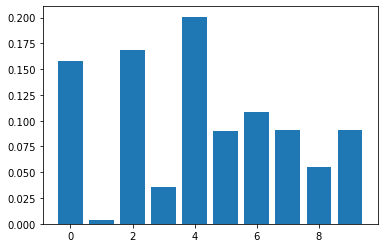

In [84]:
pyplot.bar([x for x in range(len(importance))], importance)
pyplot.show()

In [85]:
df6.shape

(579, 11)

In [86]:
df6 = df6[df6['DATASET'] == 1]
df6.shape

(414, 11)

In [87]:
df6_age = df6['AGE'].mean()
df6_bilirubin = df6['TOTAL_BILIRUBIN'].mean()
df6_alkaline = df6['ALKALINE_PHOSPHOTASE'].mean()
df6_agr = df6['ALBUMIN_AND_GLOBULIN_RATIO'].mean()

th6 = (df6_age + df6_bilirubin + df6_alkaline + df6_agr) / 4
th6

92.69394323671499

In [88]:
res6 = []
for index, row in df6.iterrows():
    c = (row['AGE'] + row['TOTAL_BILIRUBIN'] + row['ALKALINE_PHOSPHOTASE'] + row['ALBUMIN_AND_GLOBULIN_RATIO'])/4
    if c >= th6:
        res6.append(1)
    else:
        res6.append(0)

In [89]:
df6['SEVERITY'] = res6
df6 = df6.drop('DATASET',axis = 1)

In [90]:
df6.head(10)

,AGE,GENDER,TOTAL_BILIRUBIN,DIRECT_BILIRUBIN,ALKALINE_PHOSPHOTASE,ALAMINE_AMINOTRANSFERASE,ASPARTATE_AMINOTRANSFERASE,TOTAL_PROTEINS,ALBUMIN,ALBUMIN_AND_GLOBULIN_RATIO,SEVERITY
0,65,0,0.7,0.1,187,16,18,6.8,3.3,0.90,0
1,62,1,10.9,5.5,699,64,100,7.5,3.2,0.74,1
2,62,1,7.3,4.1,490,60,68,7.0,3.3,0.89,1
3,58,1,1.0,0.4,182,14,20,6.8,3.4,1.00,0
4,72,1,3.9,2.0,195,27,59,7.3,2.4,0.40,0
5,46,1,1.8,0.7,208,19,14,7.6,4.4,1.30,0
6,26,0,0.9,0.2,154,16,12,7.0,3.5,1.00,0
7,29,0,0.9,0.3,202,14,11,6.7,3.6,1.10,0
9,55,1,0.7,0.2,290,53,58,6.8,3.4,1.00,0
10,57,1,0.6,0.1,210,51,59,5.9,2.7,0.80,0


In [91]:
X = df6.drop('SEVERITY',axis = 1)
y = df6['SEVERITY']

In [92]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.05)

In [93]:
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(393, 10)
(393,)
(21, 10)
(21,)


In [96]:
hepatitis_model = AutoML(total_time_limit=5*60,eval_metric="accuracy")

In [97]:
hepatitis_model.fit(X_train,y_train)

AutoML directory: AutoML_6
The task is binary_classification with evaluation metric accuracy
AutoML will use algorithms: ['Baseline', 'Linear', 'Decision Tree', 'Random Forest', 'Xgboost', 'Neural Network']
AutoML will ensemble available models
AutoML steps: ['simple_algorithms', 'default_algorithms', 'ensemble']
* Step simple_algorithms will try to check up to 3 models
1_Baseline accuracy 0.747475 trained in 0.68 seconds
2_DecisionTree accuracy 1.0 trained in 19.99 seconds
3_Linear accuracy 0.969697 trained in 3.02 seconds
* Step default_algorithms will try to check up to 3 models
4_Default_Xgboost accuracy 1.0 trained in 3.45 seconds
5_Default_NeuralNetwork accuracy 0.969697 trained in 1.57 seconds
6_Default_RandomForest accuracy 0.989899 trained in 3.31 seconds
* Step ensemble will try to check up to 1 model
Ensemble accuracy 1.0 trained in 0.26 seconds
AutoML fit time: 41.54 seconds
AutoML best model: 2_DecisionTree


AutoML(eval_metric='accuracy', total_time_limit=300)

In [98]:
hepatitis_model.report()

In [99]:
filename = 'models/hepatitis_model.sav'
joblib.dump(hepatitis_model,filename)

['models/hepatitis_model.sav']

In [100]:
y_predicted = hepatitis_model.predict(X_test)

In [101]:
print("Accuracy:",accuracy_score(y_test, y_predicted))

Accuracy: 0.8571428571428571


**Checking the model**

In [102]:
data = np.array([[60,0,1.2,0.3,500,65,70,7.2,3.2,0.9]])
index = [1]
col = ['AGE','GENDER','TOTAL_BILIRUBIN','DIRECT_BILIRUBIN','ALKALINE_PHOSPHOTASE','ALAMINE_AMINOTRANSFERASE','ASPARTATE_AMINOTRANSFERASE','TOTAL_PROTEINS','ALBUMIN','ALBUMIN_AND_GLOBULIN_RATIO']
test6 = pd.DataFrame(data,index,col) 
test6

,AGE,GENDER,TOTAL_BILIRUBIN,DIRECT_BILIRUBIN,ALKALINE_PHOSPHOTASE,ALAMINE_AMINOTRANSFERASE,ASPARTATE_AMINOTRANSFERASE,TOTAL_PROTEINS,ALBUMIN,ALBUMIN_AND_GLOBULIN_RATIO
1,60.0,0.0,1.2,0.3,500.0,65.0,70.0,7.2,3.2,0.9


In [103]:
predict = hepatitis_model.predict_proba(test6)
predicted = predict[0]
print(predicted)

[0. 1.]


In [104]:
if(predicted[1] > predicted[0]):
    print("Severity:Malignant")
else:
    print("Severity:Benign")

Severity:Malignant


#**HYPOTHYROIDISM**

In [105]:
df7 = pd.read_csv('disease/hypothyroidism.csv')
df7 = df7.dropna()
df7.head()

,Target,Age,Sex,on_thyroxine,query_on_thyroxine,on_antithyroid_medication,thyroid_surgery,query_hypothyroid,query_hyperthyroid,pregnant,...,TSH,T3_measured,T3,TT4_measured,TT4,T4U_measured,T4U,FTI_measured,FTI,TBG_measured
0,1,72.0,1.0,0,0,0,0,0,0,0,...,30.0,1,0.6,1,15.0,1,1.48,1,10.0,0
1,1,15.0,2.0,1,0,0,0,0,0,0,...,145.0,1,1.7,1,19.0,1,1.13,1,17.0,0
2,1,24.0,1.0,0,0,0,0,0,0,0,...,0.0,1,0.2,1,4.0,1,1.00,1,0.0,0
3,1,24.0,2.0,0,0,0,0,0,0,0,...,430.0,1,0.4,1,6.0,1,1.04,1,6.0,0
4,1,77.0,1.0,0,0,0,0,0,0,0,...,7.3,1,1.2,1,57.0,1,1.28,1,44.0,0


In [106]:
X = df7.drop('Target',axis = 1)
y = df7['Target']

In [107]:
model = DecisionTreeClassifier()
model.fit(X, y)
importance = model.feature_importances_
for i,v in enumerate(importance):
    print('Feature: %0d, Score: %.5f' % (i,v))

Feature: 0, Score: 0.15551
Feature: 1, Score: 0.02313
Feature: 2, Score: 0.01300
Feature: 3, Score: 0.00665
Feature: 4, Score: 0.00325
Feature: 5, Score: 0.00902
Feature: 6, Score: 0.01288
Feature: 7, Score: 0.00893
Feature: 8, Score: 0.00487
Feature: 9, Score: 0.00883
Feature: 10, Score: 0.00190
Feature: 11, Score: 0.00000
Feature: 12, Score: 0.00493
Feature: 13, Score: 0.00000
Feature: 14, Score: 0.13038
Feature: 15, Score: 0.00000
Feature: 16, Score: 0.12047
Feature: 17, Score: 0.00000
Feature: 18, Score: 0.11573
Feature: 19, Score: 0.00000
Feature: 20, Score: 0.14510
Feature: 21, Score: 0.00000
Feature: 22, Score: 0.23543
Feature: 23, Score: 0.00000


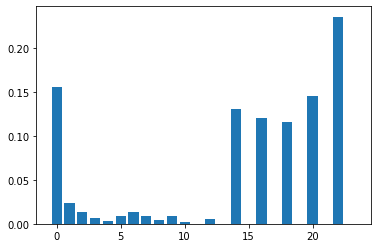

In [108]:
pyplot.bar([x for x in range(len(importance))], importance)
pyplot.show()

In [109]:
df7 = df7[df7['Target'] == 1]
df7.shape

(757, 25)

In [110]:
print("Count of on thyroxine ",len(df7[df7['on_thyroxine'] == 1]))
print("Count of Query on Thyroxine ",len(df7[df7['query_on_thyroxine'] == 1]))
print("Count of on antithyroid medication ",len(df7[df7['on_antithyroid_medication'] == 1]))
print("Count of thyroid Surgery ",len(df7[df7['thyroid_surgery'] == 1]))
print("Count of query hypothyroid ",len(df7[df7['query_hypothyroid'] == 1]))
print("Count of query Hyperthyroid ",len(df7[df7['query_hyperthyroid'] == 1]))
print("Count of Pregnant ",len(df7[df7['pregnant'] == 1]))
print("Count of sick ",len(df7[df7['sick'] == 1]))
print("Count of Tumor ",len(df7[df7['tumor'] == 1]))
print("Count of Lithium ",len(df7[df7['lithium'] == 1]))
print("Count of Goitre ",len(df7[df7['goitre'] == 1]))

Count of on thyroxine  99
Count of Query on Thyroxine  6
Count of on antithyroid medication  11
Count of thyroid Surgery  28
Count of query hypothyroid  65
Count of query Hyperthyroid  54
Count of Pregnant  14
Count of sick  27
Count of Tumor  6
Count of Lithium  1
Count of Goitre  20


In [111]:
att = ['Age','on_thyroxine','query_hypothyroid','query_hyperthyroid','sick','thyroid_surgery','TT4','FTI']
df7 = df7[att]
df7.shape

(757, 8)

In [112]:
df7_age = df7['Age'].mean()
df7_tt4 = df7['TT4'].mean()
df7_fti = df7['FTI'].mean()

th7 = (df7_age + df7_tt4 + df7_fti) / 3
th7

85.76996917657421

In [113]:
res7 = []
th7_1 = 3
for index, row in df7.iterrows():
    d = dict(row)
    val = list(d.values()).count(1)
    c = (row['Age'] + row['TT4'] + row['FTI'])/3
    if c >= th7 and val >= th7_1:
        res7.append(1)
    else:
        res7.append(0)

In [114]:
df7['SEVERITY'] = res7

In [115]:
df7.head(10)

,Age,on_thyroxine,query_hypothyroid,query_hyperthyroid,sick,thyroid_surgery,TT4,FTI,SEVERITY
0,72.0,0,0,0,0,0,15.0,10.0,0
1,15.0,1,0,0,0,0,19.0,17.0,0
2,24.0,0,0,0,0,0,4.0,0.0,0
3,24.0,0,0,0,0,0,6.0,6.0,0
4,77.0,0,0,0,0,0,57.0,44.0,0
5,85.0,0,1,0,0,0,27.0,23.0,0
6,64.0,0,0,0,0,1,54.0,63.0,0
7,72.0,0,0,0,0,0,34.0,32.0,0
10,69.0,0,0,0,0,0,53.0,61.0,0
11,75.0,0,0,0,0,0,38.0,41.0,0


In [116]:
X = df7.drop('SEVERITY',axis = 1)
y = df7['SEVERITY']

In [117]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.05)

In [118]:
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(719, 8)
(719,)
(38, 8)
(38,)


In [120]:
hypothyroid_model = AutoML(total_time_limit=5*60,eval_metric="accuracy")

In [121]:
hypothyroid_model.fit(X_train,y_train)

AutoML directory: AutoML_7
The task is binary_classification with evaluation metric accuracy
AutoML will use algorithms: ['Baseline', 'Linear', 'Decision Tree', 'Random Forest', 'Xgboost', 'Neural Network']
AutoML will ensemble available models
AutoML steps: ['simple_algorithms', 'default_algorithms', 'ensemble']
* Step simple_algorithms will try to check up to 3 models
1_Baseline accuracy 0.972973 trained in 0.77 seconds
2_DecisionTree accuracy 1.0 trained in 3.3 seconds
3_Linear accuracy 1.0 trained in 2.82 seconds
* Step default_algorithms will try to check up to 3 models
4_Default_Xgboost accuracy 0.989189 trained in 3.41 seconds
5_Default_NeuralNetwork accuracy 0.994595 trained in 1.61 seconds
6_Default_RandomForest accuracy 1.0 trained in 3.38 seconds
* Step ensemble will try to check up to 1 model
Ensemble accuracy 1.0 trained in 0.51 seconds
AutoML fit time: 25.47 seconds
AutoML best model: 2_DecisionTree


AutoML(eval_metric='accuracy', total_time_limit=300)

In [122]:
hypothyroid_model.report()

In [123]:
filename = 'models/hypothyroid_model.sav'
joblib.dump(hypothyroid_model,filename)

['models/hypothyroid_model.sav']

In [124]:
y_predicted = hypothyroid_model.predict(X_test)

In [125]:
print("Accuracy:",accuracy_score(y_test, y_predicted))

Accuracy: 1.0


**Checking the model**

In [126]:
data = np.array([[62,0,1,1,0,0,15,10]])
index = [1]
col = ['Age', 'on_thyroxine', 'thyroid_surgery', 'query_hypothyroid', 'query_hyperthyroid', 'sick', 'TT4', 'FTI']
test7 = pd.DataFrame(data,index,col) 
test7

,Age,on_thyroxine,thyroid_surgery,query_hypothyroid,query_hyperthyroid,sick,TT4,FTI
1,62,0,1,1,0,0,15,10


In [127]:
predict = hypothyroid_model.predict_proba(test7)
predicted = predict[0]
print(predicted)

[1. 0.]


In [128]:
if(predicted[1] > predicted[0]):
    print("Severity:Malignant")
else:
    print("Severity:Benign")

Severity:Benign
